# eda008
snap_to_gridのバミューダトライアングル以外の適用可能性

In [30]:
import os
import pandas as pd
import numpy as np
import ipynb_path
import matplotlib.pyplot as plt
from matplotlib_venn import venn2, venn2_circles
import seaborn as sns
import plotly
import plotly.express as px
from tqdm.notebook import tqdm
%matplotlib inline
pd.set_option('display.max_rows', 200)

In [31]:
def get_nb_name():
    nb_path = ipynb_path.get()
    nb_name = nb_path.rsplit('/',1)[1].replace('.ipynb','')
    return nb_name

In [32]:
def calc_haversine(lat1, lon1, lat2, lon2):
    """Calculates the great circle distance between two points
    on the earth. Inputs are array-like and specified in decimal degrees.
    """
    RADIUS = 6_367_000
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + \
        np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    dist = 2 * RADIUS * np.arcsin(a**0.5)
    return dist

In [33]:
def visualize_trafic(df, center, zoom=9):
    fig = px.scatter_mapbox(df,
                            
                            # Here, plotly gets, (x,y) coordinates
                            lat="latDeg",
                            lon="lngDeg",
                            
                            #Here, plotly detects color of series
                            color="phoneName",
                            labels="phoneName",
                            
                            zoom=zoom,
                            center=center,
                            height=1000,
                            width=2000)
    fig.update_layout(mapbox_style='stamen-terrain')
    fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
    fig.update_layout(title_text="GPS trafic")
    fig.show()

In [34]:
def visualize_collection(df, collection):
    target_df = df[df['collectionName']==collection].copy()
    lat_center = target_df['latDeg'].mean()
    lng_center = target_df['lngDeg'].mean()
    center = {"lat":lat_center, "lon":lng_center}
    
    visualize_trafic(target_df, center)

In [35]:
# directory setting
nb_name = get_nb_name()
INPUT = '../input/google-smartphone-decimeter-challenge'
OUTPUT = '../output/' + nb_name
os.makedirs(OUTPUT, exist_ok=True)

In [36]:
# reading data
train = pd.read_csv(INPUT + '/' + 'baseline_locations_train.csv')
test = pd.read_csv(INPUT + '/' + 'baseline_locations_test.csv')
sub = pd.read_csv(INPUT + '/' + 'sample_submission.csv')
gt = pd.read_csv(INPUT + '/prep/ground_truth_train.csv')

In [37]:
train

,collectionName,phoneName,millisSinceGpsEpoch,latDeg,lngDeg,heightAboveWgs84EllipsoidM,phone
0,2020-05-14-US-MTV-1,Pixel4,1273529463442,37.423575,-122.094091,-34.06,2020-05-14-US-MTV-1_Pixel4
1,2020-05-14-US-MTV-1,Pixel4,1273529464442,37.423578,-122.094101,-33.29,2020-05-14-US-MTV-1_Pixel4
2,2020-05-14-US-MTV-1,Pixel4,1273529465442,37.423573,-122.094111,-30.99,2020-05-14-US-MTV-1_Pixel4
3,2020-05-14-US-MTV-1,Pixel4,1273529466442,37.423583,-122.094121,-32.83,2020-05-14-US-MTV-1_Pixel4
4,2020-05-14-US-MTV-1,Pixel4,1273529467442,37.423579,-122.094114,-34.49,2020-05-14-US-MTV-1_Pixel4
...,...,...,...,...,...,...,...
131337,2021-04-29-US-SJC-2,SamsungS20Ultra,1303760315000,37.334460,-121.899600,-8.09,2021-04-29-US-SJC-2_SamsungS20Ultra
131338,2021-04-29-US-SJC-2,SamsungS20Ultra,1303760316000,37.334472,-121.899583,-7.59,2021-04-29-US-SJC-2_SamsungS20Ultra
131339,2021-04-29-US-SJC-2,SamsungS20Ultra,1303760317000,37.334491,-121.899597,-8.35,2021-04-29-US-SJC-2_SamsungS20Ultra
131340,2021-04-29-US-SJC-2,SamsungS20Ultra,1303760318000,37.334495,-121.899583,-8.73,2021-04-29-US-SJC-2_SamsungS20Ultra


In [38]:
train['phone'] = train['collectionName'] + '_' + train['phoneName']
gt['phone'] = gt['collectionName'] + '_' + gt['phoneName']

In [39]:
collections = train['collectionName'].unique()

for idx in tqdm(train.index):
    lat = train.at[idx, 'latDeg']
    lng = train.at[idx, 'lngDeg']
    gt['latDeg_pred'] = lat
    gt['lngDeg_pred'] = lng
    gt['dist'] = calc_haversine(gt['latDeg'], gt['lngDeg'], gt['latDeg_pred'], gt['lngDeg_pred'])
    closest_dist = gt['dist'].min()
    train.loc[idx, 'closest_dist'] = closest_dist

  0%|          | 0/131342 [00:00<?, ?it/s]

In [42]:
train.to_csv(OUTPUT + '/train.csv', index=False)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


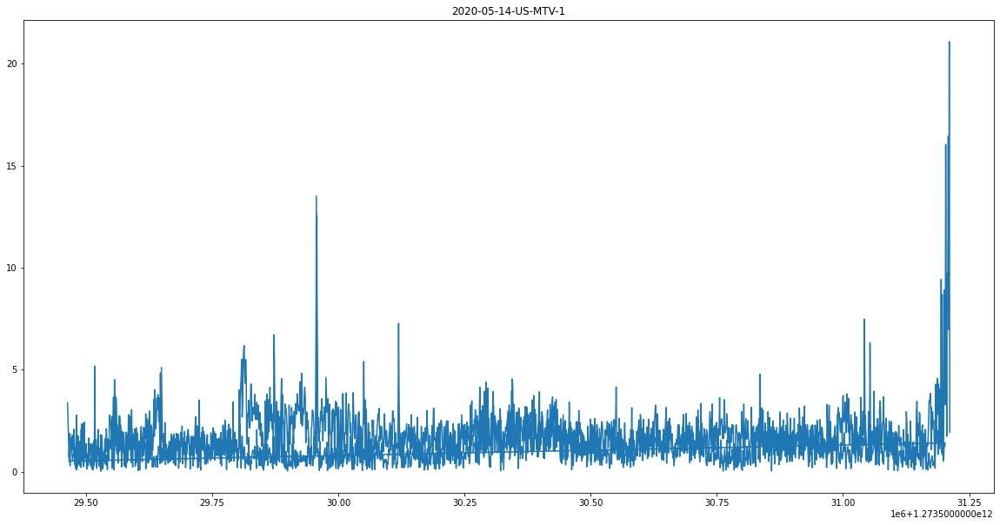

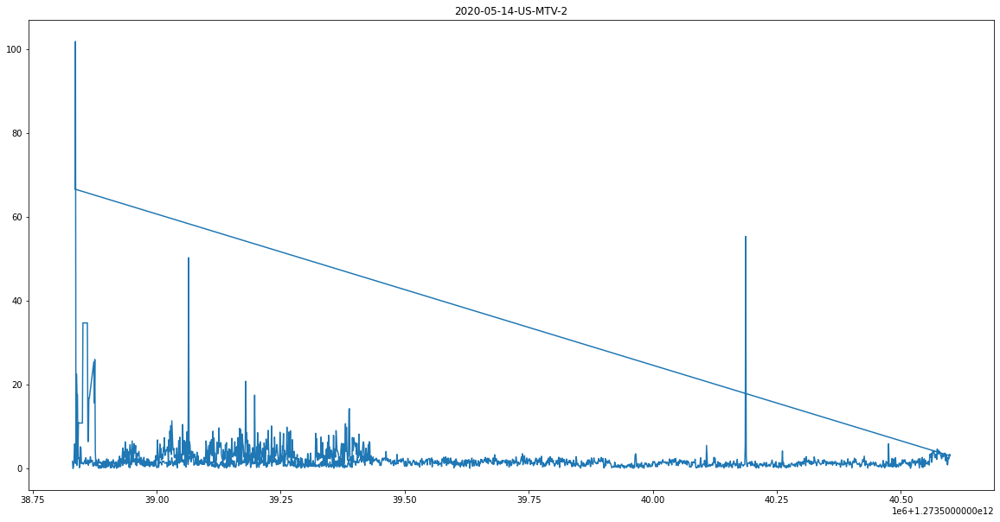

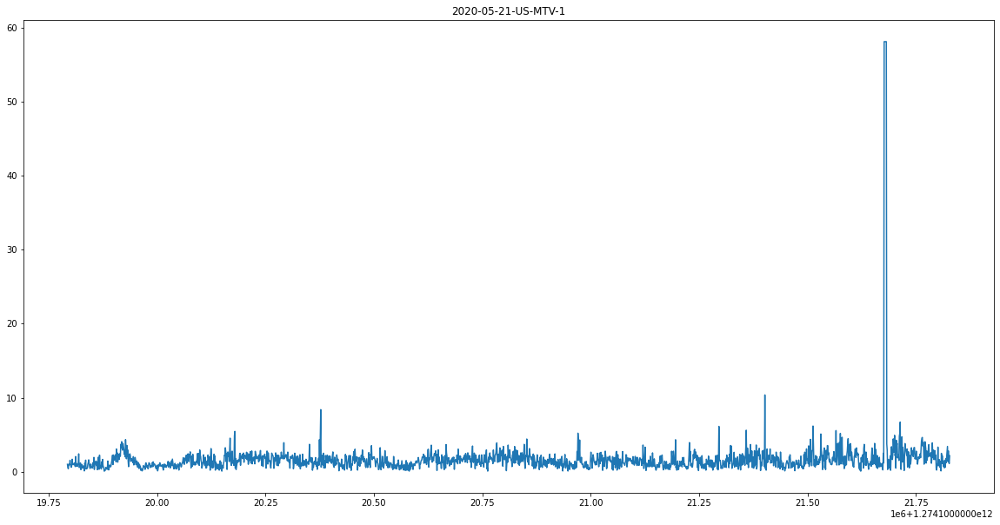

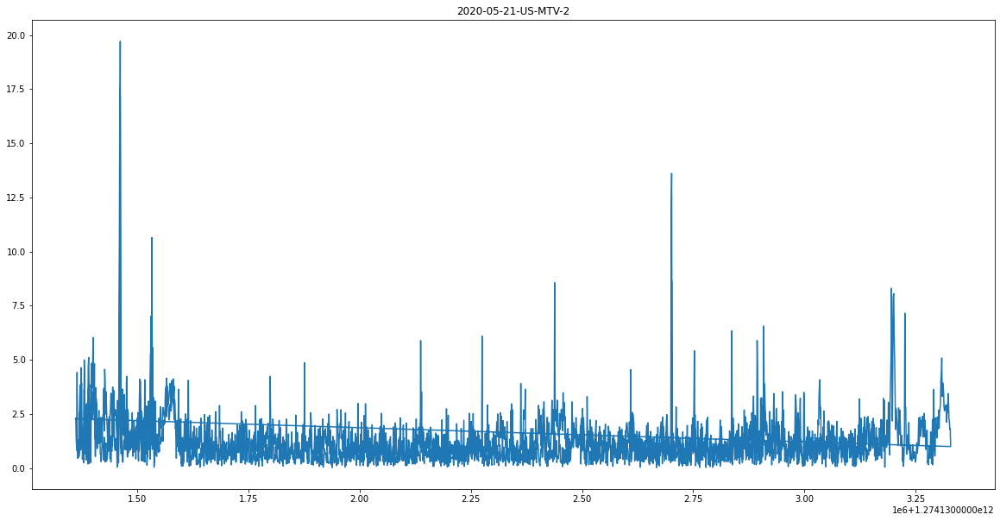

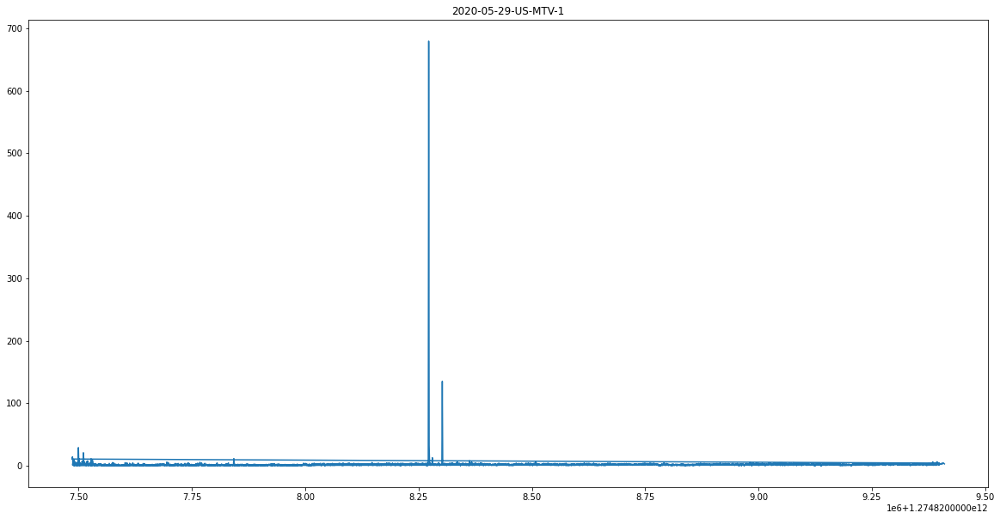

...

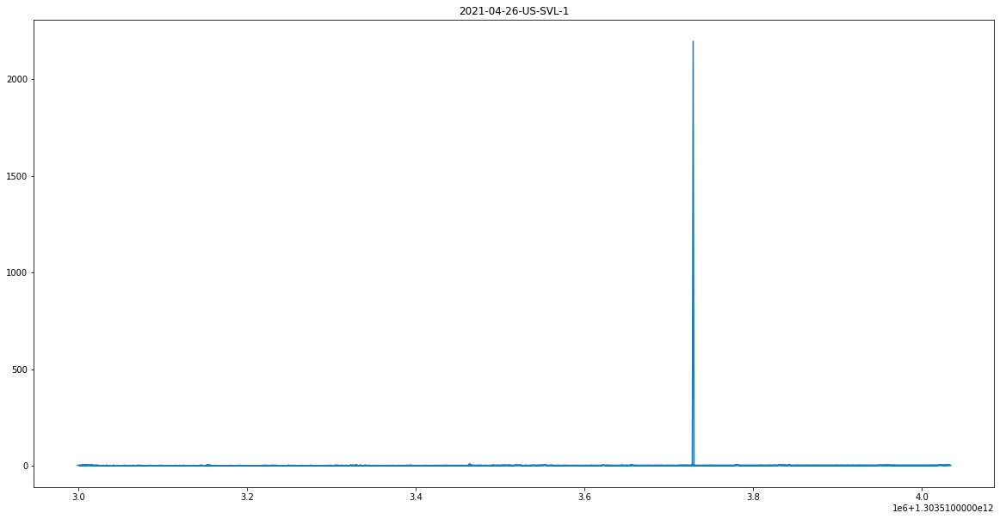

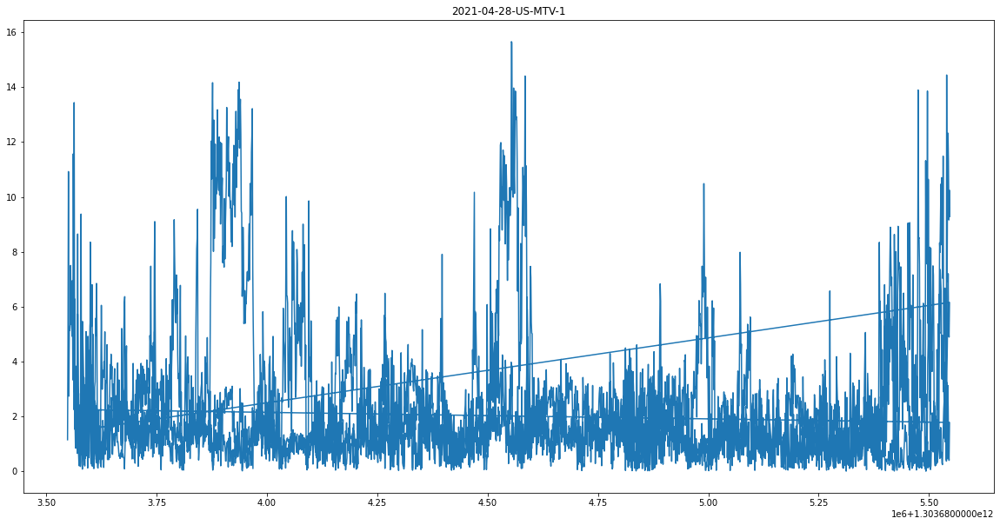

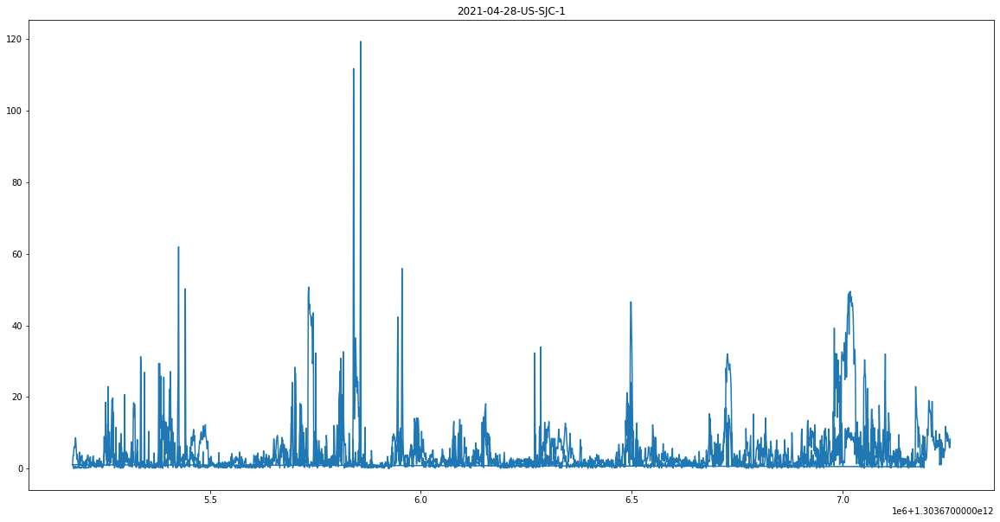

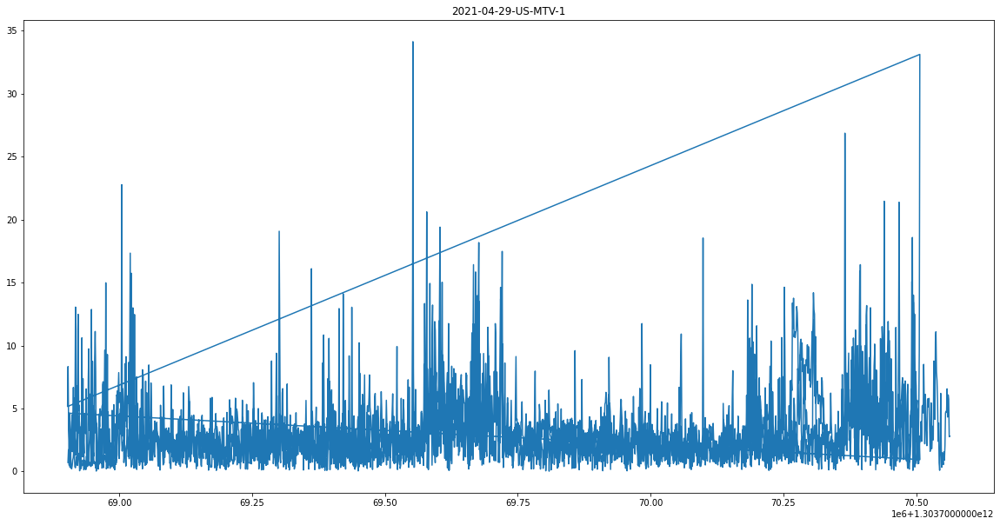

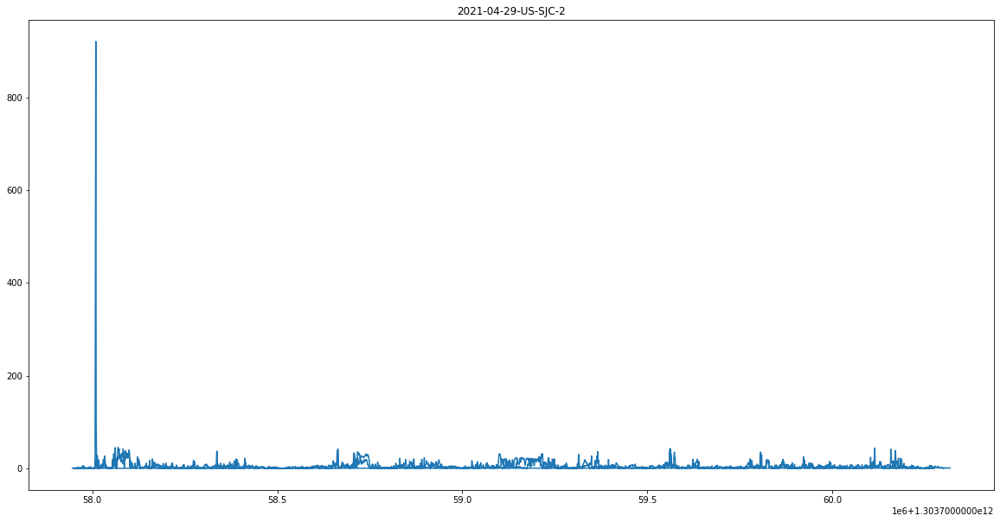

In [47]:
for collection in collections:
    tmp = train[train['collectionName']==collection].copy()
    plt.figure(figsize=(20,10))
    plt.plot(tmp['millisSinceGpsEpoch'], tmp['closest_dist'])
    plt.title(collection)

In [54]:
base_train['area'] = base_train['collectionName'].str.split('-', expand=True)[4]
base_test['area'] = base_test['collectionName'].str.split('-', expand=True)[4]

In [55]:
base_train.drop_duplicates('collectionName')['area'].value_counts()

MTV    18
SVL     4
SJC     3
RWC     2
SF      2
Name: area, dtype: int64

In [56]:
base_test.drop_duplicates('collectionName')['area'].value_counts()

MTV    13
SJC     3
SVL     1
RWC     1
PAO     1
Name: area, dtype: int64

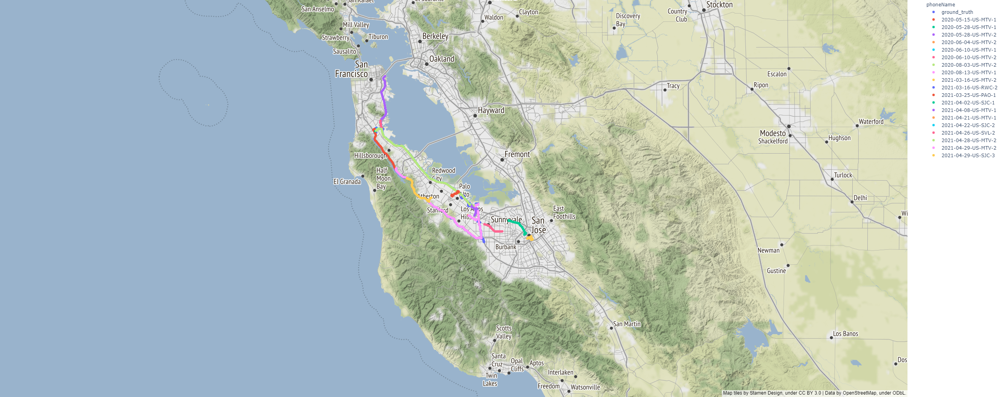

In [58]:
tmp1 = ground_truth.copy()
tmp1['phoneName'] = 'ground_truth'
tmp2 = base_test.copy()
tmp2['phoneName'] = tmp2['collectionName']
tmp = pd.concat([tmp1, tmp2])
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')

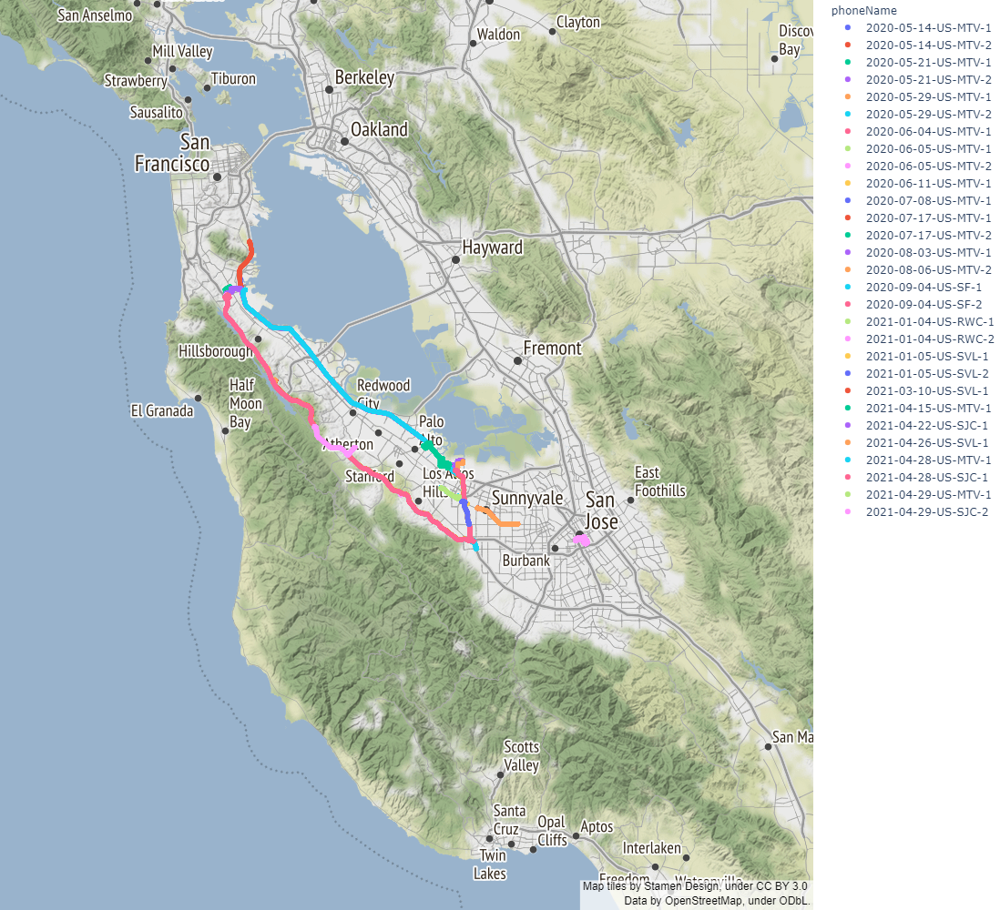

In [59]:
tmp = ground_truth.copy()
tmp['phoneName'] = tmp['collectionName']
tmp['collectionName'] = 'all'
visualize_collection(tmp, 'all')